# Setup

In [ ]:
!git clone https://github.com/krglkvrmn/Apidaecin_AMP_search.git
!mv Apidaecin_AMP_search/* .
!rm -rf Apidaecin_AMP_search
!pip install -r requirements.txt

In [1]:
import os
import pickle
import random
import re
import sys
from collections import defaultdict
from copy import deepcopy
from functools import partial
from typing import Callable, List

import matplotlib.pyplot as plt
import numpy as np
import optuna
import seaborn as sns
import torch
from Bio import SeqIO
from Bio.pairwise2 import align
from loguru import logger
from sklearn.model_selection import train_test_split, StratifiedKFold
from torch import nn
from torch.utils.tensorboard import SummaryWriter
from tqdm.notebook import tqdm

from src.logs import delete_all_runs, tb_run, reinit_tensorboard_local
from src.metrics import f1_score, precision_score, matthews_corrcoef, recall_score, accuracy_score
from src.models import HybridModel, SimpleCNN
from src.parameters import ModelParameters, Hyperparameters
from src.processing import SequenceAugmentator, OneHotEncoder, get_single_seq_patches
from src.training import Trainer
from src.validation import nested_cv, NestedCVresults



LOGS_BASE_DIR = 'runs'

def reinit_tensorboard(log_dir: str = "default_run", clear_log: bool = True):
    """
    Reinitialize tensorboard on colab
    
    :param log_dir: directory where particular run is stored
    :type log_dir: str
    :param clear_log: whether to clear previous results or not
    :type clear_log: bool
    """
    logs_base_dir = "/content/runs"
    logs_dir = os.path.join(logs_base_dir, log_dir)
    if clear_log:    
        shutil.rmtree(logs_dir, ignore_errors=True)
        os.makedirs(logs_dir, exist_ok=True)
    %reload_ext tensorboard
    %tensorboard --logdir {logs_dir} --reuse_port False
        
def delete_all_runs():
    """
    Delete all logs used by tensorboard
    """
    shutil.rmtree(LOGS_BASE_DIR, ignore_errors=True)
    os.makedirs(LOGS_BASE_DIR, exist_ok=True)
    
def tb_run(run_name: str) -> str:
    """
    Create tensorboard run instance (bind it with log_dir)
    
    :param run_name: Name of model run
    :type run_name: str
    :return: Path to run logs
    :rtype: str
    """
    return os.path.join(LOGS_BASE_DIR, run_name)

# Load data

In [2]:
DATA_PATH = "data"
PROTEINS_PATH = os.path.join(DATA_PATH, "not_api_proteins.fasta")
APD_PATH = os.path.join(DATA_PATH, "APD_DB.fasta")
APIDAECINS_PATH = os.path.join(DATA_PATH, "apidaecins.fasta")

In [3]:
# Load all apidaecin sequences (includes unfiltered peptides that do not belong to the group)
apidaecins_sequences = list(set(map(lambda rec: str(rec.seq), SeqIO.parse(APIDAECINS_PATH, "fasta"))))
len(apidaecins_sequences)

132

In [4]:
# Load protein non-AMP sequences
proteins_sequences = list(set(map(lambda rec: str(rec.seq), SeqIO.parse(PROTEINS_PATH, "fasta"))))
len(proteins_sequences)

205391

In [5]:
# Load AMP from APD3 database
apd_sequences = set()
for record in SeqIO.parse(APD_PATH, "fasta"):
    if "Apidaecin" in record.description or "apidaecin" in record.description:
        continue
    apd_sequences.add(str(record.seq))
apd_sequences = list(apd_sequences)
len(apd_sequences)

3125

# Filter data

In [6]:
# Pro-apidaecins are filtered apidaecins without signal peptides
PRO_APIDAECINS_PATH = os.path.join(DATA_PATH, "pro-apidaecins.fasta")

In [7]:
# Signal peptides are cut based on alignment position of first linker
linkers = ["RREAKPEAEP", "RREAEPEAEP", "RREAEPDP", "RREAEPDP", "RREAGPEPEP", "RREPDPEP", "REAKPEPEPEP", "RREPDPEP", "RREAEPDP", "EADPAKP", "QAEPGKP"]

approved_records = []

approved_seqs = set()
for record in SeqIO.parse(APIDAECINS_PATH, "fasta"):
    if "PREDICTED" not in record.description:
        seq_alignments = []
        for linker in linkers:
            alignments = align.localxs(record.seq, linker, -11, -1)
            first_linker_algn = min(alignments, key=lambda x: x.start)
            seq_alignments.append(first_linker_algn)
        max_score = max(seq_alignments, key=lambda x: x.score).score
        best_alignments = list(filter(lambda x: x.score == max_score, seq_alignments))
        best_alignment = min(best_alignments, key=lambda x: x.start)
        if 80 > best_alignment.start > 12 and best_alignment.score > 6:
            new_seq = record.seq[best_alignment.start:]
            if new_seq not in approved_seqs:
                record.seq = new_seq
                approved_records.append(record)
            approved_seqs.add(new_seq)

# Uncomment line below to save filtered sequences to file
# SeqIO.write(approved_records, PRO_APIDAECINS_PATH, "fasta")

In [8]:
# Load filtered apidaecins
pro_apidaecins_sequences = list(set(map(lambda rec: str(rec.seq), SeqIO.parse(PRO_APIDAECINS_PATH, "fasta"))))
len(pro_apidaecins_sequences)

76

In [9]:
# Take a look on sequences of interest
for record in SeqIO.parse(PRO_APIDAECINS_PATH, "fasta"):
    print(record.id, record.seq)

KAG6796292.1 RREAKPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRLRREAKPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRI
KOX78578.1 RREADPEPEPKRPRIPHIPRPRPPQIPRPRPPHPRLRREADPEPEPDNRPDILIYIPPPGPPHTRLRREADPEPEPDNRPDILIYIPPPGPPHTRLRREADPEPEPDNRPDILIYIPPPGPPHTVSN
NP_001011613.1 RREAKPEAEPGNNRPIYIPQPRPPHPRLRREAEPKAEPGNNRPIYIPQPRPPHPRLRREAESEAEPGNNRPVYIPQPRPPHPRLRREPEAEPGNNRPVYIPQPRPPHPRLRREPEAEPGNNRPVYIPQPRPPHPRI
NP_001011642.1 RREAEPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRI
OAD59390.1 RREAEPEPEPSNRPVYVPAPRPPHPRLRREAEPEPEPSNRPVYVPPPRPPHPRLRREAEPEPEPSNRPVYVPAPRPPHPRLRREAEPEPGRPVNMPKPRPIHVPRPRPPHPRLRREAEPEPGRPVNMPKPRPIHVPRPRPPHPRLRREAEPEPGRPVNMPKPRPIHVPRPRPPHPRI
PBC28057.1 RREAEPEAEPGNNRPVYIPQPRPPHPRLRREAKPEAEPGNNRPVYIPQPRPPHPRLRRKPEPEAEPGNNRPRLRREAEPEAEPGNNRPVYIPQPRPPHPRLRREAKPEAEPGNNRPVYIPQPRPPHPVNI
sp|Q06602.1|APD73_APIME RREAKPEAEPGNNRPV

# Augmentations

## Test augmentations

In [10]:
# Set up augmentation
augmentator = SequenceAugmentator("BLOSUM45", replacement_proba_factor=50)
patches = get_single_seq_patches(pro_apidaecins_sequences[0])

In [11]:
# Test augmentation on small portion of data. 'False' means augmentation occured
for patch in patches[:10]:
    new_str = augmentator.apply_augmentation(patch)
    print(patch, new_str, patch==new_str, sep="\n", end="\n\n")

RREADPEPQRPRPQVPQPRP
RRBADPEPQRPRPMVPQPRP
False

READPEPQRPRPQVPQPRPS
READPEPZQPRPQVPQPRPC
False

EADPEPQRPRPQVPQPRPSR
EADPEPQRPRPQVPHPRPDR
False

ADPEPQRPRPQVPQPRPSRP
CDPEPQRPRPQVPKPRPSRP
False

DPEPQRPRPQVPQPRPSRPR
DPEPQKPRPQVPQPKPTRPR
False

PEPQRPRPQVPQPRPSRPRP
PEPQRPRPQVPQPKPFRPRP
False

EPQRPRPQVPQPRPSRPRPQ
EPQRPRPQVPQPRPSRPZPQ
False

PQRPRPQVPQPRPSRPRPQQ
PQRPRPQVPQPRPARPKPQQ
False

QRPRPQVPQPRPSRPRPQQV
QRPRPQVPQPRPTRPRPQQM
False

RPRPQVPQPRPSRPRPQQVP
RPRPQVPQPRPVRPRPQQFP
False



# Train-test training

## Training setup

In [13]:
# Here you can set up adjustable training and model parameters 
torch.manual_seed(42)

DEVICE = "cpu"

mp = ModelParameters(
    n_classes = 2,
    embedding_size = 20,
    conv_channels = 64,
    conv_kernel_size = 13,
    dropout_rate = 0.2,

    blstm_output_size = 128,
    lstm_output_size = 128,

    activation = "relu"
)

hp = Hyperparameters(
        device = DEVICE,
        batch_size = 1000,
        patch_size = 50,
        patch_stride = 1,
        substitution_matrix = "BLOSUM45",
        replacement_proba_factor = 250,
        pos_proba = 0.1,
        db_proba = 0.1,

        model_parameters = mp,
        encoder = OneHotEncoder(alphabet="prot", device=DEVICE),

        criterion = nn.CrossEntropyLoss(),
        optimizer = "adam",
        scheduler = None,
        lr = 1e-4,

        metric_fns = (matthews_corrcoef, accuracy_score, precision_score, recall_score, f1_score)
)

In [14]:
# Train-test split of data
raw_X = np.array(pro_apidaecins_sequences + proteins_sequences + apd_sequences)
pos_labels = [1] * len(pro_apidaecins_sequences)
neg_labels = [0] * len(proteins_sequences) + [2] * len(apd_sequences)
raw_y = np.array(pos_labels + neg_labels)
X_train, X_test, y_train, y_test = train_test_split(raw_X, raw_y, random_state=42, shuffle=True, test_size=0.2)

In [15]:
trainer = Trainer(HybridModel, X_train, X_test,
                  y_train, y_test, hp, setup=True)

2022-06-27 14:08:59.178 | DEBUG    | src.dataset:__init__:63 - Created dataset. pos_proba=0.1, db_proba=0.1, len_data=348808, len_labels=348808, pos_count=8659, db_count=11563, neg_count=328586, pos_weight=4.028271162951842, db_weight=3.0165873908155327, neg_weight=0.8492339904925956
2022-06-27 14:09:00.142 | DEBUG    | src.dataset:__init__:63 - Created dataset. pos_proba=0.1, db_proba=0.1, len_data=86603, len_labels=86603, pos_count=1290, db_count=3117, neg_count=82196, pos_weight=6.713410852713179, db_weight=2.7784087263394293, neg_weight=0.8428925981799601


In [15]:
reinit_tensorboard("Model2", clear_log=True)

In [18]:
# Start training
visualize_sequences = ["RREAEPEAEPGNNRPVYIPPPRPPHPRLRREAEPEAEPGNNRPVYIPQPRPPHPRTAVALVSASRSFFSFAVPRALEQQRFRYSHATKR",
                       "RRIRPRPPRLPRPRPRPLPFPRPGPRPIPRPLPFPRPGPRPIPRPLPFPRPGPRPIPRPL",
                       "MKKIYVAGGCFWGVQGFLKTIKGIKKTTVGYANSLLENPTYELVKSHVTDAVETVEVIYDENILSLKDIVKKLFAVIDPTARNYQGPDHGRQYRNGFYFVDQEDGVMLRELMLEFSKKYEKPLATEILPLDNYYLAEDYHQDYFDKHPNAVCHIKF"]

writer = SummaryWriter(tb_run("Model2"))
trainer.train(n_epochs=100, valid=1, writer=writer, vis_seqs=visualize_sequences, cache_embeddings=False)

2022-06-26 18:47:31.025 | DEBUG    | train_funcs.training:train:197 - Training started. Hyperparameters(batch_size=1000, patch_size=50, patch_stride=1, substitution_matrix='BLOSUM45', replacement_proba_factor=250, pos_proba=0.1, db_proba=0.1, model_parameters=ModelParameters(n_classes=2, embedding_size=20, conv_channels=64, conv_kernel_size=13, dropout_rate=0.2, blstm_input_size=64, blstm_output_size=128, lstm_output_size=128, activation='relu'), encoder=<train_funcs.processing.OneHotEncoder object at 0x7fa58e016290>, criterion=CrossEntropyLoss(), optimizer='adam', scheduler=None, lr=0.0001, metric_fns=(<function matthews_corrcoef at 0x7fa59128eef0>, <function accuracy_score at 0x7fa59128ec20>, functools.partial(<function precision_score at 0x7fa5912943b0>, zero_division=0), functools.partial(<function recall_score at 0x7fa591294440>, zero_division=0), functools.partial(<function f1_score at 0x7fa591294050>, zero_division=0)))
2022-06-26 18:47:46.355 | INFO     | train_funcs.training:t

(0.499295711517334,
 {'matthews_corrcoef': 0.0,
  'accuracy_score': 0.9837109329615429,
  'precision_score': 0.0,
  'recall_score': 0.0,
  'f1_score': 0.0})

## Validate on APD3 peptides

Code below shows AMP from APD3 database, whose fragments were predicted as apidaecin-like AMP. In the best case there should not be proline rich AMP, that are not apidaecins

In [19]:
for record in SeqIO.parse(APD_PATH, "fasta"):
    mask = trainer.predict_mask(str(record.seq))
    if sum(mask) > 0:
        print(record.id)
        print(record.seq)
        print(*mask, sep="")

# Hyperparameter optimization & Nested CV

## Functions

Set up objective function that executes code for single optuna trial. This includes parameters suggesting and cross-validation.

You can manually adjust suggested parameters and their boundaries

In [15]:
def objective(trial: optuna.Trial, trainer_preset: Callable, X: List[str], y: List[int],
              kfold: StratifiedKFold, mp_preset: Callable, hp_preset: Callable, outer_split: int, use_tensorboard: bool = False):
    """
    Function to maximize precision by optuna
    
    :param trial: Optuna single trial
    :type trial: optuna.Trial
    :param trainer_preset: Trainer class with preset arguments
    :type trainer_preset: Callable
    :param X: A list of sequences of any length
    :type X: List[str]
    :param y: A list of labels corresponding to each sequence in X
    :type y: List[int]
    :param kfold: Sklearn Kfold object producing splits for data
    :type kfold: StratifiedKfold
    :param mp_preset: ModelParameters class with preset parameters
    :type mp_preset: Callable
    :param hp_preset: Hyperparameters class with preset parameters
    :type hp_preset: Callable
    :param outer_split: Current outer split
    :type outer split: int
    :param use_tensorboard: Whether to use Tensorboard for logging
    :type use_tensorboard: bool
    """
    logger.info(f"Running nested CV, outer split {outer_split[0]}/{outer_split[1]} trial #{trial.number}")

    patch_size = trial.suggest_int("patch_size", 20, 60)
    patch_stride = trial.suggest_int("patch_stride", 1, patch_size, log=True)
    substitution_matrix = trial.suggest_categorical("substitution_matrix", ["BLOSUM45", "BLOSUM62", "BLOSUM90"])
    embedding_size = trial.suggest_int("embedding_size", 5, 40)
    conv_kernel_size = trial.suggest_int("conv_kernel_size", 2, patch_size, log=True)
    lr = trial.suggest_loguniform("lr", 1e-4, 5e-3)
    optimizer = trial.suggest_categorical("optimizer", list(Trainer._optimizers_map.keys()))
    activation = trial.suggest_categorical("activation", list(Trainer._activations_map.keys()))
    # dropout_rate = trial.suggest_float("dropout_rate", 0.05, 0.6)
    # db_proba = trial.suggest_float("db_proba", 0.05, 0.2)
    # pos_proba = trial.suggest_float("pos_proba", 0.05, 0.2)
    # replacement_proba_factor = trial.suggest_int("replacement_proba_factor", 1, 1000)
    
    suggested_parameters = dict(patch_size=patch_size, patch_stride=patch_stride,
                                substitution_matrix=substitution_matrix, embedding_size=embedding_size,
                                conv_kernel_size=conv_kernel_size, lr=lr,
                                optimizer=optimizer, activation=activation)
    logger.info(f"Suggested parameters: {suggested_parameters}")
    
    mp = mp_preset(
        embedding_size=embedding_size,
        conv_kernel_size=conv_kernel_size,
        activation=activation,
        # dropout_rate=dropout_rate,
    )

    hp = hp_preset(
        substitution_matrix=substitution_matrix,
        patch_size=patch_size,
        optimizer=optimizer,
        lr=lr,
        patch_stride=patch_stride,
        # db_proba=db_proba,
        # pos_proba=pos_proba,
        # replacement_proba_factor=replacement_proba_factor,
        model_parameters=mp,
    )

    crossval_metrics = defaultdict(list)
    for current_split, (train_indices, val_indices) in enumerate(kfold.split(X, y)):
        logger.info(f"Running nested CV, outer split {outer_split[0]}/{outer_split[1]}, Training inner split {current_split+1}/{kfold.n_splits}")
        logger.debug(f"Performing kfold split. Train split sample: {train_indices[0:31:2]}, Val split sample: {val_indices[0:31:2]}")
        X_train, X_val = X[train_indices], X[val_indices]
        y_train, y_val = y[train_indices], y[val_indices]
        trainer = trainer_preset(X_train=X_train, X_val=X_val,
                                 y_train=y_train, y_val=y_val,
                                 hyperparameters=deepcopy(hp))
        if use_tensorboard:
            inner_split_tb_run = tb_run(f"nested_CV/outer_split_{outer_split[0]}/trial_{trial.number}/inner_split_{current_split+1}")
            reinit_tensorboard_local(inner_split_tb_run, clear_log=True)
            writer = SummaryWriter(log_dir=inner_split_tb_run)
        else:
            writer = None
        loss, metrics = trainer.train(n_epochs=30, valid=3, writer=writer)
        for metric, value in metrics.items():
            crossval_metrics[metric].append(value)
    
    crossval_metrics_mean = {metric:sum(values)/len(values) for metric, values in crossval_metrics.items()}
    if use_tensorboard:
        hp_logdir = tb_run(f"nested_CV/outer_split_{outer_split[0]}/trial_{trial.number}/hyperparameters")
        reinit_tensorboard_local(hp_logdir, clear_log=True)
        writer = SummaryWriter(log_dir=hp_logdir)
        writer.add_hparams(suggested_parameters, crossval_metrics_mean)
        writer.flush()

    return -crossval_metrics_mean["precision_score"]

## Load data

In [17]:
raw_X = np.array(pro_apidaecins_sequences + proteins_sequences + apd_sequences)
pos_labels = [1] * len(pro_apidaecins_sequences)
neg_labels = [0] * len(proteins_sequences) + [2] * len(apd_sequences)
raw_y = np.array(pos_labels + neg_labels)

## Setup fixed parameters

Here are specified fixed parameters that shall not change

In [18]:
DEVICE = "cpu"

mp_preset = partial(
    ModelParameters,
    conv_channels=64,
    blstm_output_size=128,
    lstm_output_size=128,
)

hp_preset = partial(
    Hyperparameters,
    device=DEVICE,
    encoder=OneHotEncoder(device=DEVICE),
    metric_fns=(precision_score, recall_score)
)

trainer_preset = partial(
    Trainer,
    model_class=HybridModel,
    setup=True,
)

In [27]:
n_trials = 30
outer_k = 5
inner_k = 2
print(f"Total learning rounds: {n_trials * outer_k * inner_k}")

Total learning rounds: 300


## Run nested cv

In [54]:
nested_cv_results = nested_cv(
    trainer_preset=trainer_preset,
    objective=objective,
    X=raw_X,
    y=raw_y,
    hp_preset=hp_preset,
    mp_preset=mp_preset,
    n_trials=n_trials,
    outer_k=outer_k,
    inner_k=inner_k,
    random_state=42,
    use_tensorboard=True)

2022-06-26 19:26:07.772 | INFO     | train_funcs.validation:nested_cv:160 - Started nested 5-fold CV
2022-06-26 19:26:07.789 | INFO     | train_funcs.validation:nested_cv:162 - Running nested CV, training outer split 1/5
[I 2022-06-26 19:26:07,877] A new study created in memory with name: no-name-9b0b7e5c-e287-47f0-9454-c68f4f1e5f0a
2022-06-26 19:26:07.878 | INFO     | __main__:objective:26 - Running nested CV, outer split 1/5 trial #0
2022-06-26 19:26:07.879 | INFO     | __main__:objective:45 - Suggested parameters: {'patch_size': 60, 'patch_stride': 3, 'substitution_matrix': 'BLOSUM90', 'embedding_size': 31, 'conv_kernel_size': 14, 'lr': 0.0008772760485297, 'optimizer': 'adamw', 'activation': 'elu'}
2022-06-26 19:26:07.886 | INFO     | __main__:objective:69 - Running nested CV, outer split 1/5, Training inner split 1/2
2022-06-26 19:26:07.887 | DEBUG    | __main__:objective:71 - Performing kfold split. Train split sample: [ 2  5  7 10 12 18 22 25 33 36 38 44 46 52 58 60], Val split s

KeyboardInterrupt: 

## Save nested cv results to file

In [379]:
with open(os.path.join("cv_results", "nested_cv_results.pk"), "wb") as file:
    pickle.dump(nested_cv_results, file=file)

## Load nested cv results from file

In [32]:
with open(os.path.join("cv_results", "nested_cv_results.pk"), "rb") as file:
    loaded_cv_results = pickle.load(file)

In [34]:
# Take a look on cv results
for idx, results in enumerate(loaded_cv_results):
    print(f"Outer split {idx+1}")
    metrics_format = "\t".join([f"{metric}={value:.4f}" for metric, value in results.metrics.items()])
    hp_format = "\t".join([f"{parameter}={value}" for parameter, value in results.best_params.items()])
    print(f"Validation metrics: {metrics_format}")
    print(f"Best hyperparameters: {hp_format}")
    print()

Outer split 1
Validation metrics: precision_score=0.9946	recall_score=1.0000
Best hyperparameters: patch_size=34	patch_stride=1	substitution_matrix=BLOSUM45	embedding_size=39	conv_kernel_size=13	lr=0.004982302942769811	optimizer=adam	activation=relu

Outer split 2
Validation metrics: precision_score=0.9939	recall_score=0.9897
Best hyperparameters: patch_size=25	patch_stride=3	substitution_matrix=BLOSUM45	embedding_size=24	conv_kernel_size=13	lr=0.0018737128229293935	optimizer=adamw	activation=relu

Outer split 3
Validation metrics: precision_score=0.9954	recall_score=0.9993
Best hyperparameters: patch_size=22	patch_stride=2	substitution_matrix=BLOSUM90	embedding_size=27	conv_kernel_size=17	lr=0.0036510208313759304	optimizer=adam	activation=relu

Outer split 4
Validation metrics: precision_score=0.9772	recall_score=1.0000
Best hyperparameters: patch_size=47	patch_stride=2	substitution_matrix=BLOSUM45	embedding_size=13	conv_kernel_size=26	lr=0.004970175300749746	optimizer=adamw	activatio

In [36]:
for result in loaded_cv_results:
    print(result.best_params, result.metrics)

{'patch_size': 34, 'patch_stride': 1, 'substitution_matrix': 'BLOSUM45', 'embedding_size': 39, 'conv_kernel_size': 13, 'lr': 0.004982302942769811, 'optimizer': 'adam', 'activation': 'relu'} {'precision_score': 0.9945866141732284, 'recall_score': 1.0}
{'patch_size': 25, 'patch_stride': 3, 'substitution_matrix': 'BLOSUM45', 'embedding_size': 24, 'conv_kernel_size': 13, 'lr': 0.0018737128229293935, 'optimizer': 'adamw', 'activation': 'relu'} {'precision_score': 0.9939138576779026, 'recall_score': 0.9897435897435898}
{'patch_size': 22, 'patch_stride': 2, 'substitution_matrix': 'BLOSUM90', 'embedding_size': 27, 'conv_kernel_size': 17, 'lr': 0.0036510208313759304, 'optimizer': 'adam', 'activation': 'relu'} {'precision_score': 0.9954225352112676, 'recall_score': 0.999293036408625}
{'patch_size': 47, 'patch_stride': 2, 'substitution_matrix': 'BLOSUM45', 'embedding_size': 13, 'conv_kernel_size': 26, 'lr': 0.004970175300749746, 'optimizer': 'adamw', 'activation': 'leakyrelu'} {'precision_score':

# Evaluation

## Visualize latent representation

Build 2 components UMAP images of latent data representation (before FC layer)

In [26]:
# Here you can set up adjustable training and model parameters 

torch.manual_seed(42)

DEVICE = "cpu"

mp = ModelParameters(
    n_classes = 2,
    embedding_size = 20,
    conv_channels = 64,
    conv_kernel_size = 13,
    dropout_rate = 0.2,

    blstm_input_size = 64,
    blstm_output_size = 128,
    lstm_output_size = 128,

    activation = "relu"
)

hp = Hyperparameters(
        device = DEVICE,
        batch_size = 1000,
        patch_size = 50,
        patch_stride = 1,
        substitution_matrix = "BLOSUM45",
        replacement_proba_factor = 250,
        pos_proba = 0.1,
        db_proba = 0.1,

        model_parameters = mp,
        encoder = OneHotEncoder(alphabet="prot", device=DEVICE),

        criterion = nn.CrossEntropyLoss(),
        optimizer = "adam",
        scheduler = None,
        lr = 1e-4,

        metric_fns = (matthews_corrcoef, accuracy_score, precision_score, recall_score, f1_score)
)

In [27]:
raw_X = np.array(pro_apidaecins_sequences + proteins_sequences + apd_sequences)
pos_labels = [1] * len(pro_apidaecins_sequences)
neg_labels = [0] * len(proteins_sequences) + [2] * len(apd_sequences)
raw_y = np.array(pos_labels + neg_labels)
X_train, X_test, y_train, y_test = train_test_split(raw_X, raw_y, random_state=42, shuffle=True, test_size=0.2)

In [28]:
trainer = Trainer(HybridModel, X_train, X_test,
                  y_train, y_test, hp, setup=True)

❗`cache_embeddings` option is very memory consuming, especially if you use SimpleSNN model❗

In [29]:
trainer.train(n_epochs=100, valid=1, writer=None, vis_seqs=None, cache_embeddings=True)

2022-06-24 13:00:12.498 | INFO     | __main__:train:153 - Epoch: 1	Train loss: 0.659387	Validation loss: 0.577217	matthews_corrcoef: 0.0000	accuracy_score: 0.9770	precision_score: 0.0000	recall_score: 0.0000	f1_score: 0.0000
2022-06-24 13:00:16.954 | INFO     | __main__:train:153 - Epoch: 2	Train loss: 0.447536	Validation loss: 0.139074	matthews_corrcoef: 0.0000	accuracy_score: 0.9770	precision_score: 0.0000	recall_score: 0.0000	f1_score: 0.0000
2022-06-24 13:00:21.418 | INFO     | __main__:train:153 - Epoch: 3	Train loss: 0.310686	Validation loss: 0.143482	matthews_corrcoef: 0.0000	accuracy_score: 0.9770	precision_score: 0.0000	recall_score: 0.0000	f1_score: 0.0000
2022-06-24 13:00:25.903 | INFO     | __main__:train:153 - Epoch: 4	Train loss: 0.279410	Validation loss: 0.111530	matthews_corrcoef: 0.0000	accuracy_score: 0.9770	precision_score: 0.0000	recall_score: 0.0000	f1_score: 0.0000
2022-06-24 13:00:30.323 | INFO     | __main__:train:153 - Epoch: 5	Train loss: 0.236023	Validation l

(0.0009577669552527368,
 {'matthews_corrcoef': 0.9934170279095095,
  'accuracy_score': 0.9997010257117888,
  'precision_score': 0.9871794871794872,
  'recall_score': 1.0,
  'f1_score': 0.9935483870967742})

In [ ]:
embedding_history = {}
for epoch, (embeddings, labels) in tqdm(trainer.embedding_cache.items()):
    um = umap.UMAP()
    reduced_embedding = um.fit_transform(embeddings)
    embedding_history[epoch - 1] = (reduced_embedding, labels)

  0%|          | 0/100 [00:00<?, ?it/s]

/home/roman/anaconda3/envs/NN/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


Create UMAP images and save them to directory `images` in alphabetic order

/home/roman/anaconda3/envs/NN/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/roman/anaconda3/envs/NN/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/roman/anaconda3/envs/NN/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretati

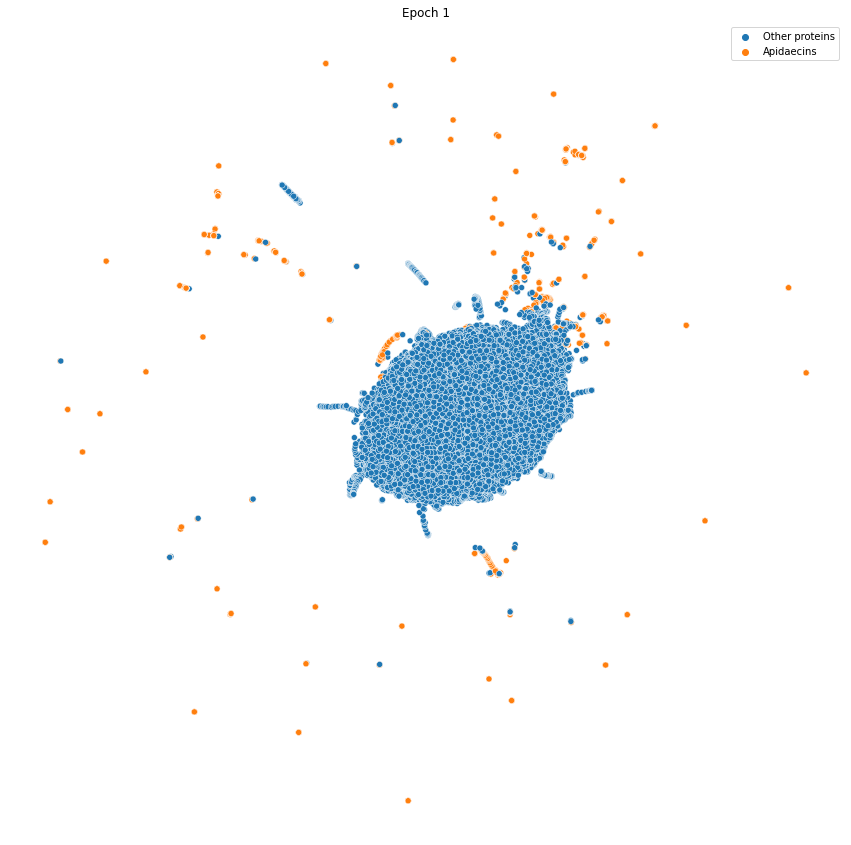

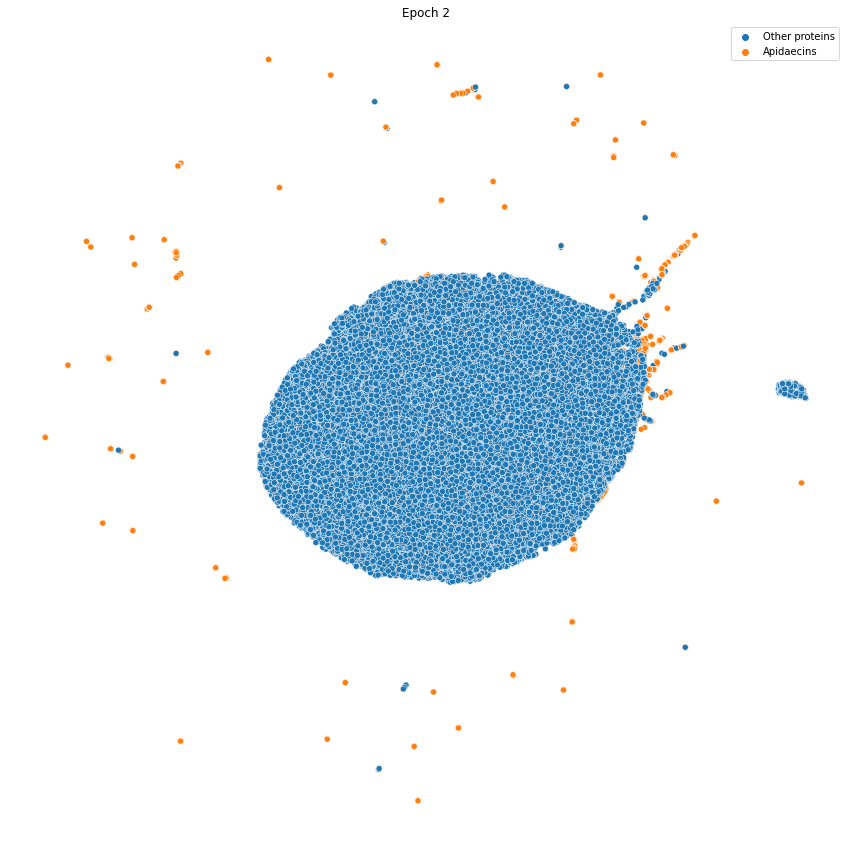

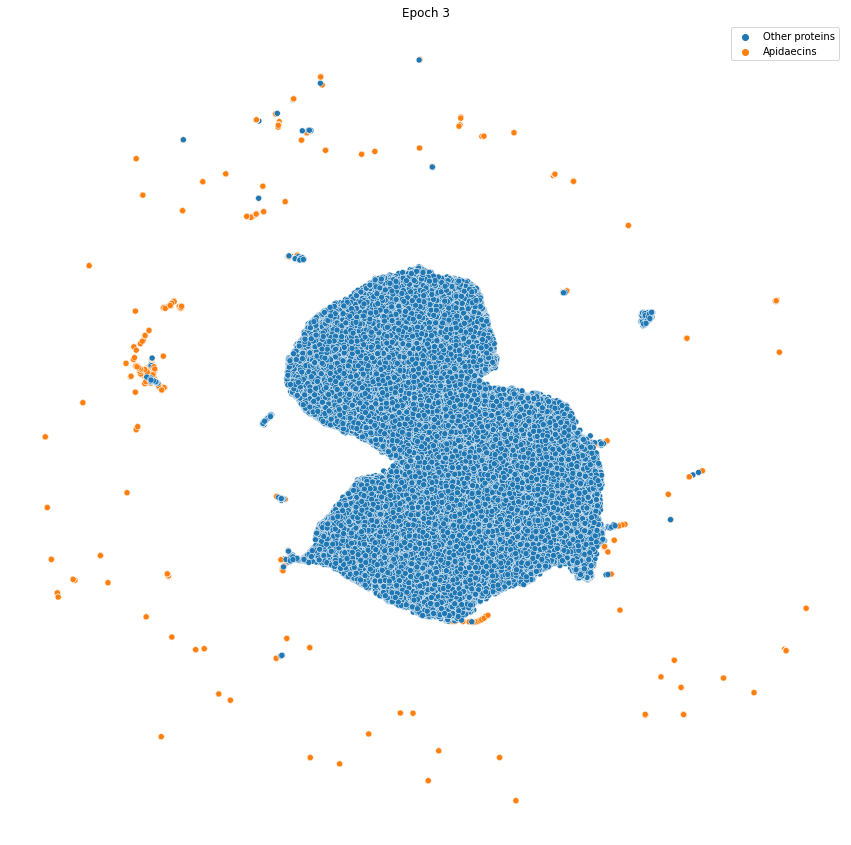

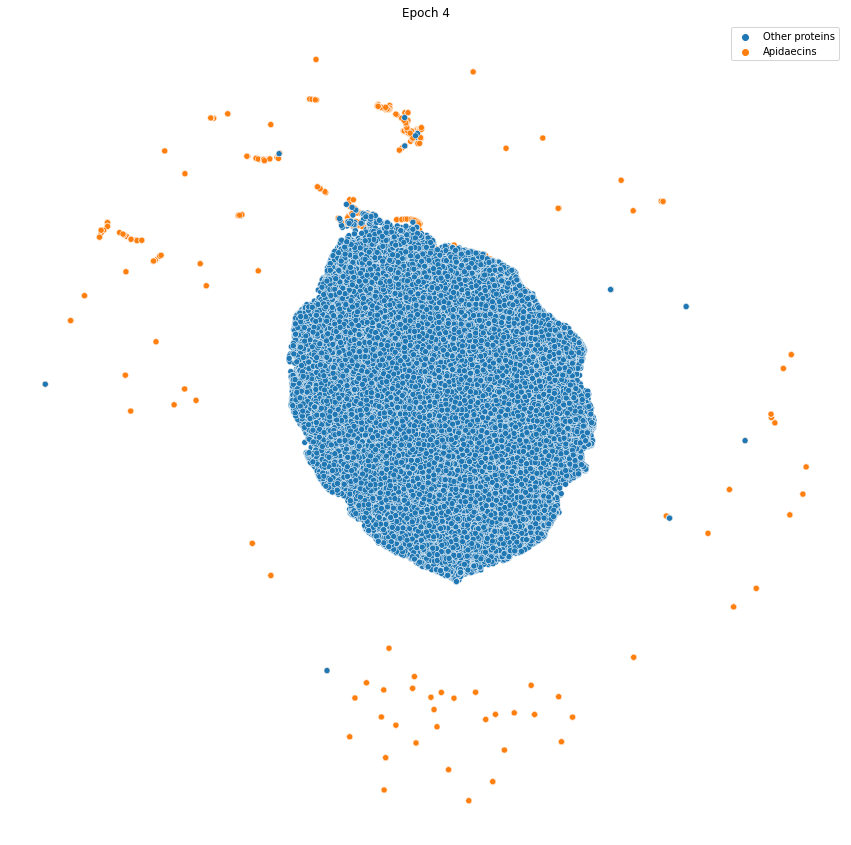

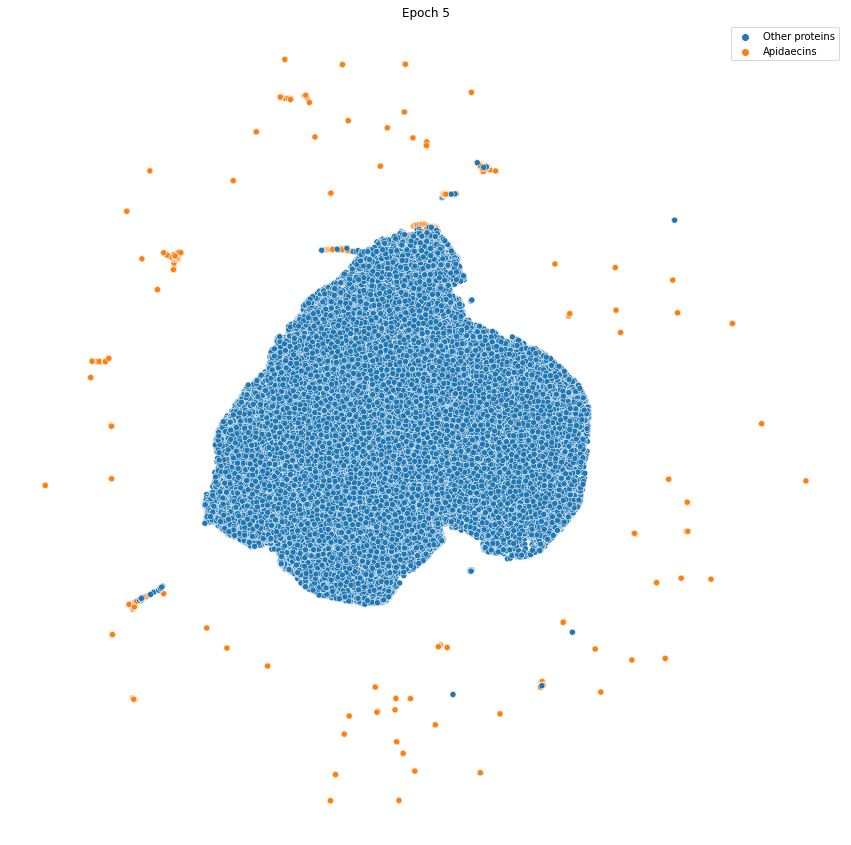

...

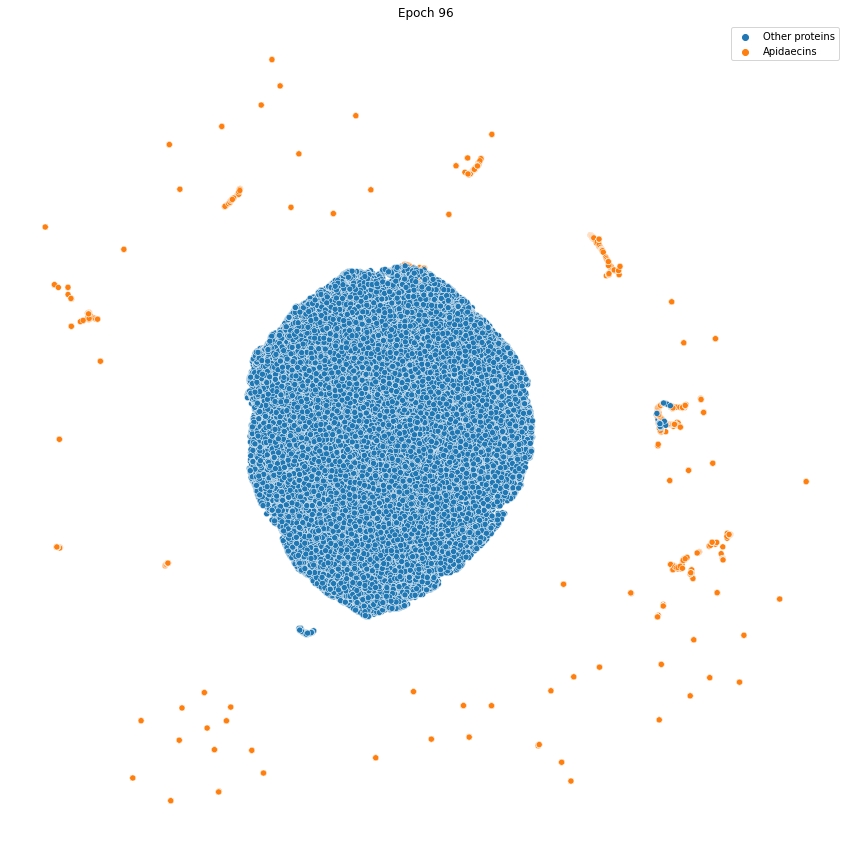

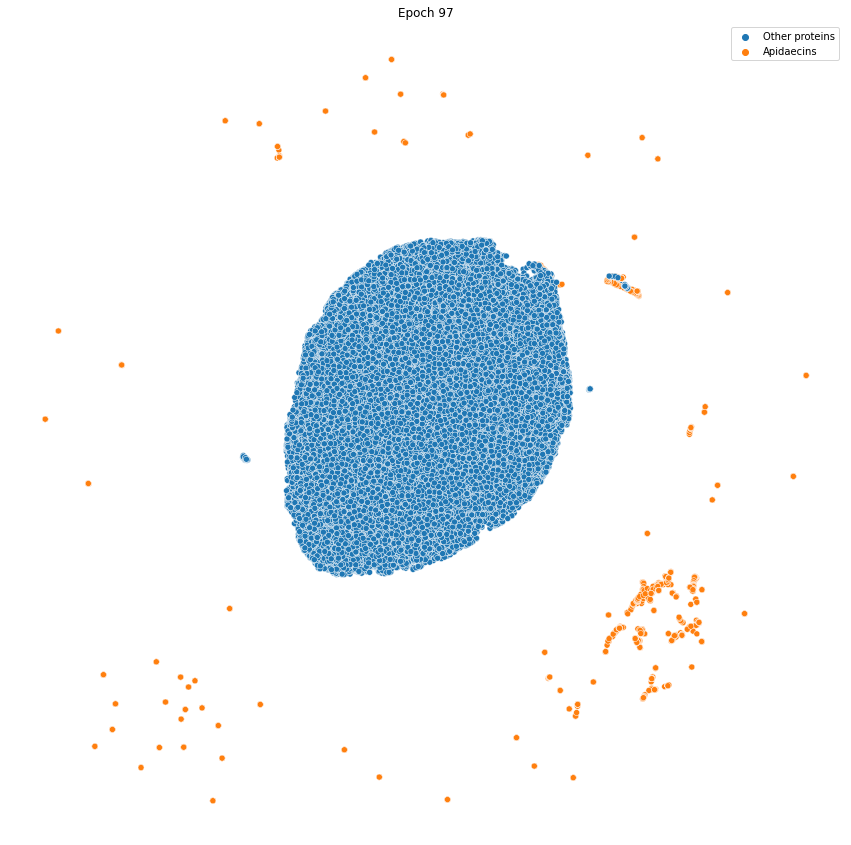

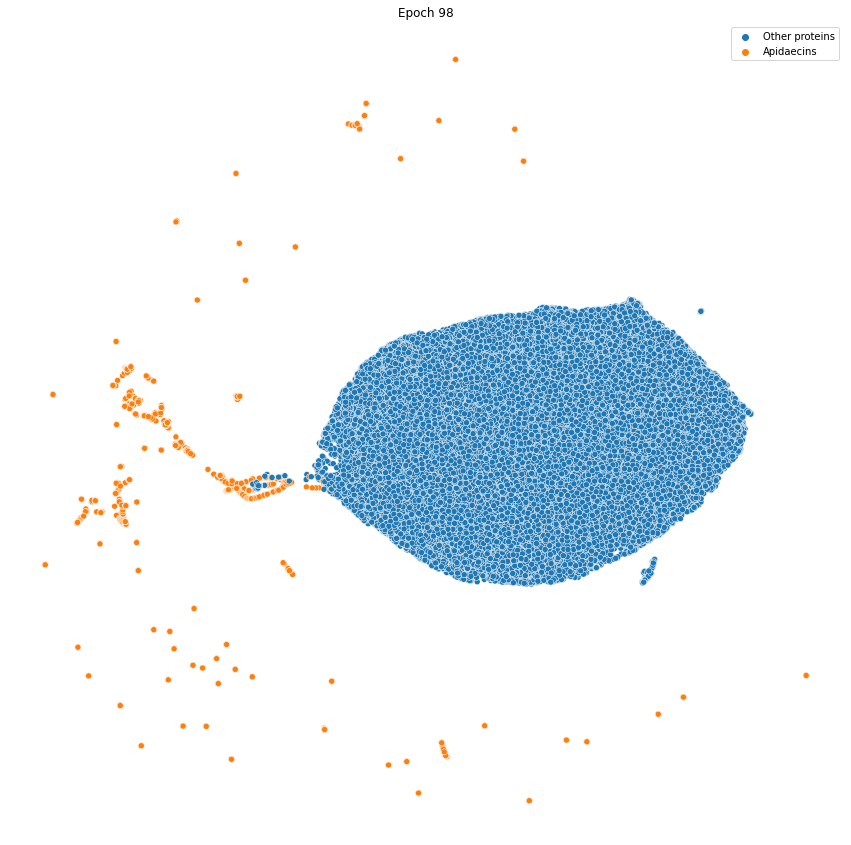

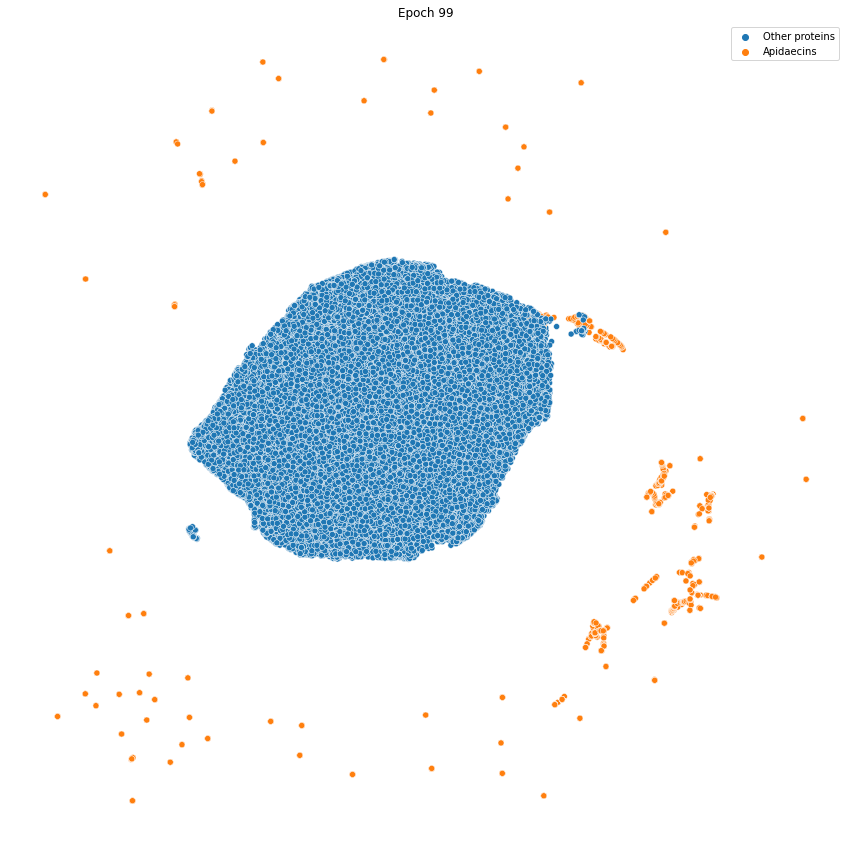

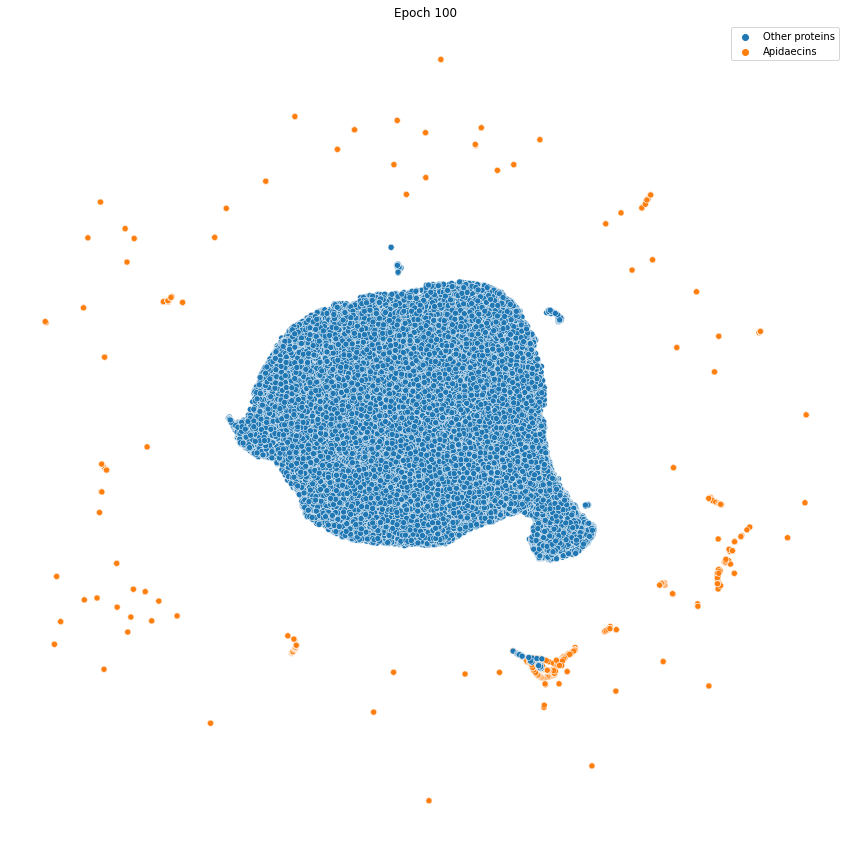

In [ ]:
if "images" in os.listdir():
    shutil.rmtree("images")
else:
    os.mkdir("images")

plt.rc("figure", figsize=(15, 15))

suffixes = product(ascii_lowercase, repeat=2)

for epoch in sorted(list(embedding_history.keys())):
    embeddings, labels = embedding_history[epoch]
    new_labels = []
    for label in labels:
        if label:
            new_labels.append("Apidaecins")
        else:
            new_labels.append("Other proteins")
    plt.figure()
    sns.scatterplot(embeddings[:, 0], embeddings[:, 1], hue=new_labels)
    plt.title(f"Epoch {epoch}")
    plt.axis("off")
    suffix = "".join(next(suffixes))
    plt.savefig(os.path.join("images", f"HybridModel_embeddings_{suffix}.png"), )

## Final training

Below are the best hyperparameters selected on nested cross validation with optuna

In [19]:
torch.manual_seed(42)

DEVICE = "cpu"

mp = ModelParameters(
    n_classes = 2,
    embedding_size = 39,
    conv_channels = 128,
    conv_kernel_size = 12,
    dropout_rate = 0.2,

    blstm_output_size = 256,
    lstm_output_size = 256,

    activation = "relu"
)

hp = Hyperparameters(
        device = DEVICE,
        batch_size = 1000,
        patch_size = 33,
        patch_stride = 1,
        substitution_matrix = "BLOSUM45",
        replacement_proba_factor = 250,
        pos_proba = 0.1,
        db_proba = 0.1,

        model_parameters = mp,
        encoder = OneHotEncoder(alphabet="prot", device=DEVICE),

        criterion = nn.CrossEntropyLoss(),
        optimizer = "adam",
        scheduler = None,
        lr = 0.0047474,

        metric_fns = ()
)

In [30]:
raw_X = np.array(pro_apidaecins_sequences + proteins_sequences + apd_sequences)
pos_labels = [1] * len(pro_apidaecins_sequences)
neg_labels = [0] * len(proteins_sequences) + [2] * len(apd_sequences)
raw_y = np.array(pos_labels + neg_labels)

In [43]:
trainer = Trainer(HybridModel, X_train=raw_X, X_val=None,
                  y_train=raw_y, y_val=None, hyperparameters=hp, setup=True)

In [ ]:
run_name = "Final_training"
reinit_tensorboard(run_name, clear_log=True)

In [44]:
writer = SummaryWriter(log_dir=tb_run(run_name))

trainer.train(n_epochs=100, writer=writer, valid=False)

2022-05-22 22:39:32.409 | INFO     | __main__:train:150 - Epoch: 1	Train loss: 0.210783		
2022-05-22 22:41:22.308 | INFO     | __main__:train:150 - Epoch: 2	Train loss: 0.030392		
2022-05-22 22:43:12.634 | INFO     | __main__:train:150 - Epoch: 3	Train loss: 0.022240		
2022-05-22 22:45:00.155 | INFO     | __main__:train:150 - Epoch: 4	Train loss: 0.020854		
2022-05-22 22:46:46.414 | INFO     | __main__:train:150 - Epoch: 5	Train loss: 0.012866		
2022-05-22 22:48:31.900 | INFO     | __main__:train:150 - Epoch: 6	Train loss: 0.007789		
2022-05-22 22:50:17.062 | INFO     | __main__:train:150 - Epoch: 7	Train loss: 0.005232		
2022-05-22 22:52:00.989 | INFO     | __main__:train:150 - Epoch: 8	Train loss: 0.005726		
2022-05-22 22:53:44.679 | INFO     | __main__:train:150 - Epoch: 9	Train loss: 0.003583		
2022-05-22 22:55:27.610 | INFO     | __main__:train:150 - Epoch: 10	Train loss: 0.003650		
2022-05-22 22:57:09.892 | INFO     | __main__:train:150 - Epoch: 11	Train loss: 0.003337		
2022-05-

## Model save

Save model weights and hyperparameters to files. `models` directory contains 2 subdirectories: `weights` and `params`. `weights` contain model weights saved by pytorch, all files have versions. `params` contain saved hyperparameters of model, files also have versions

In [46]:
# This will produce `models/weights/HybridModel_vX.pt` and `models/params/HybridModel_vX.pk`
trainer.save_model("models", "HybridModel")

## Model load

In [22]:
# Predictor is instance of Trainer class with pretrained model
# It uses the most recent version of model found in `models` directory
predictor = Trainer.make_predictor("models", "HybridModel")

2022-06-27 03:17:02.707 | INFO     | train_funcs.training:make_predictor:391 - Loading HybridModel from models
2022-06-27 03:17:02.725 | INFO     | train_funcs.training:make_predictor:412 - Model HybridModel_v3 successfully loaded


## Leave one-out proteome validation 

### Set up test data

In [32]:
test_species = [
    'Vespa_mandarinia',
    'Bombus_pyrosoma',
    'Megalopta_genalis',
    'Leptopilina_heterotoma',
    'Apis_mellifera_caucasica'
]

In [142]:
species_pro_apidaecins = {}
for species in test_species:
    parser = SeqIO.parse(PRO_APIDAECINS_PATH, "fasta")
    species_api_records = filter(lambda rec: species.replace("_", " ") in rec.description, parser)
    species_pro_apidaecins[species] = {record.id: str(record.seq) for record in species_api_records}
    print(species, "has", len(species_pro_apidaecins[species]), "selected apidaecins")

Vespa_mandarinia has 13 selected apidaecins
Bombus_pyrosoma has 2 selected apidaecins
Megalopta_genalis has 3 selected apidaecins
Leptopilina_heterotoma has 4 selected apidaecins
Apis_mellifera_caucasica has 1 selected apidaecins


In [139]:
species_apidaecins = {}
for species in test_species:
    parser = SeqIO.parse(APIDAECINS_PATH, "fasta")
    species_api_records = filter(lambda rec: species.replace("_", " ") in rec.description, parser)
    species_apidaecins[species] = {record.id: str(record.seq) for record in species_api_records}
    print(species, "has", len(species_apidaecins[species]), "unfiltered apidaecins")

Vespa_mandarinia has 15 unfiltered apidaecins
Bombus_pyrosoma has 4 unfiltered apidaecins
Megalopta_genalis has 4 unfiltered apidaecins
Leptopilina_heterotoma has 4 unfiltered apidaecins
Apis_mellifera_caucasica has 1 unfiltered apidaecins


### Load true labels for proteomes

In [83]:
true_masks = defaultdict(dict)

for species, species_api_records_dict in species_pro_apidaecins.items():
    proteome_records = list(SeqIO.parse(os.path.join("data", "proteomes", f"{species}.faa"), "fasta"))
    for record in proteome_records:
        if record.id in species_api_records_dict:
            match = re.search(species_api_records_dict[record.id], str(record.seq))
            true_masks[species][record.id] = [0] * len(record)
            true_masks[species][record.id][match.start():match.end()] = [1] * (match.end() - match.start())
        else:
            true_masks[species][record.id] = [0] * len(record)

In [146]:
true_masks_unfiltered = defaultdict(dict)

for species, species_api_records_dict in species_apidaecins.items():
    proteome_records = list(SeqIO.parse(os.path.join("data", "proteomes", f"{species}.faa"), "fasta"))
    for record in proteome_records:
        if record.id in species_api_records_dict:
            match = re.search(species_api_records_dict[record.id], str(record.seq))
            true_masks_unfiltered[species][record.id] = [0] * len(record)
            true_masks_unfiltered[species][record.id][match.start():match.end()] = [1] * (match.end() - match.start())
        else:
            true_masks_unfiltered[species][record.id] = [0] * len(record)

### Set up training

In [106]:
# Set hyperparameters

torch.manual_seed(42)

DEVICE = "cpu"

mp = ModelParameters(
    n_classes = 2,
    embedding_size = 39,
    conv_channels = 128,
    conv_kernel_size = 12,
    dropout_rate = 0.2,

    blstm_output_size = 256,
    lstm_output_size = 256,

    activation = "relu"
)

hp = Hyperparameters(
        device=DEVICE,
        batch_size = 1000,
        patch_size = 33,
        patch_stride = 1,
        substitution_matrix = "BLOSUM45",
        replacement_proba_factor = 250,
        pos_proba = 0.1,
        db_proba = 0.1,

        model_parameters = mp,
        encoder = OneHotEncoder(alphabet="prot", device=DEVICE),

        criterion = nn.CrossEntropyLoss(),
        optimizer = "adam",
        scheduler = None,
        lr = 0.0015,

        metric_fns = ()
)

### Partial cross-validation

In [107]:
predicted_masks = defaultdict(dict)

for species in test_species:
    # Load data
    train_pro_apidaecins_records = filter(lambda rec: species not in rec.description, SeqIO.parse(PRO_APIDAECINS_PATH, "fasta"))
    train_pro_apidaecins_sequences = list(map(lambda rec: str(rec.seq), train_pro_apidaecins_records))
    
    # Make training set
    raw_X = np.array(train_pro_apidaecins_sequences + proteins_sequences + apd_sequences)
    pos_labels = [1] * len(train_pro_apidaecins_sequences)
    neg_labels = [0] * len(proteins_sequences) + [2] * len(apd_sequences)
    raw_y = np.array(pos_labels + neg_labels)
    
    # Train model
    trainer = Trainer(HybridModel, X_train=raw_X, X_val=None,
                      y_train=raw_y, y_val=None, hyperparameters=hp, setup=True)
    trainer.train(n_epochs=100, valid=False)
    
    # ====================== Validation ==============================================================
    proteome_records = list(SeqIO.parse(os.path.join("data", "proteomes", f"{species}.faa"), "fasta"))
    
    for record in tqdm(proteome_records):
        mask = trainer.predict_mask(str(record.seq), stride=50)
        mask_sum = mask.sum()
        if mask_sum:
            mask = trainer.predict_mask(str(record.seq), stride=1).tolist()
        else:
            mask = [0] * len(record)
            
        predicted_masks[species][record.id] = mask

2022-06-24 00:18:41.897 | INFO     | __main__:train:153 - Epoch: 1	Train loss: 0.125559		
2022-06-24 00:19:14.650 | INFO     | __main__:train:153 - Epoch: 2	Train loss: 0.022123		
2022-06-24 00:19:46.973 | INFO     | __main__:train:153 - Epoch: 3	Train loss: 0.012956		
2022-06-24 00:20:19.546 | INFO     | __main__:train:153 - Epoch: 4	Train loss: 0.007775		
2022-06-24 00:20:52.363 | INFO     | __main__:train:153 - Epoch: 5	Train loss: 0.004471		
2022-06-24 00:21:25.286 | INFO     | __main__:train:153 - Epoch: 6	Train loss: 0.004055		
2022-06-24 00:21:57.332 | INFO     | __main__:train:153 - Epoch: 7	Train loss: 0.003806		
2022-06-24 00:22:29.191 | INFO     | __main__:train:153 - Epoch: 8	Train loss: 0.002033		
2022-06-24 00:23:01.657 | INFO     | __main__:train:153 - Epoch: 9	Train loss: 0.002259		
2022-06-24 00:23:34.464 | INFO     | __main__:train:153 - Epoch: 10	Train loss: 0.001913		
2022-06-24 00:24:06.754 | INFO     | __main__:train:153 - Epoch: 11	Train loss: 0.002205		
2022-06-

  0%|          | 0/27198 [00:00<?, ?it/s]

2022-06-24 01:16:28.094 | INFO     | __main__:train:153 - Epoch: 1	Train loss: 0.151471		
2022-06-24 01:16:59.961 | INFO     | __main__:train:153 - Epoch: 2	Train loss: 0.022825		
2022-06-24 01:17:31.920 | INFO     | __main__:train:153 - Epoch: 3	Train loss: 0.018565		
2022-06-24 01:18:04.943 | INFO     | __main__:train:153 - Epoch: 4	Train loss: 0.014797		
2022-06-24 01:18:37.428 | INFO     | __main__:train:153 - Epoch: 5	Train loss: 0.008266		
2022-06-24 01:19:09.898 | INFO     | __main__:train:153 - Epoch: 6	Train loss: 0.007135		
2022-06-24 01:19:41.909 | INFO     | __main__:train:153 - Epoch: 7	Train loss: 0.005550		
2022-06-24 01:20:14.230 | INFO     | __main__:train:153 - Epoch: 8	Train loss: 0.002861		
2022-06-24 01:20:46.077 | INFO     | __main__:train:153 - Epoch: 9	Train loss: 0.002901		
2022-06-24 01:21:17.561 | INFO     | __main__:train:153 - Epoch: 10	Train loss: 0.004293		
2022-06-24 01:21:49.107 | INFO     | __main__:train:153 - Epoch: 11	Train loss: 0.003184		
2022-06-

  0%|          | 0/28292 [00:00<?, ?it/s]

2022-06-24 02:14:02.769 | INFO     | __main__:train:153 - Epoch: 1	Train loss: 0.127459		
2022-06-24 02:14:35.195 | INFO     | __main__:train:153 - Epoch: 2	Train loss: 0.022260		
2022-06-24 02:15:08.185 | INFO     | __main__:train:153 - Epoch: 3	Train loss: 0.019144		
2022-06-24 02:15:40.725 | INFO     | __main__:train:153 - Epoch: 4	Train loss: 0.012382		
2022-06-24 02:16:13.297 | INFO     | __main__:train:153 - Epoch: 5	Train loss: 0.005556		
2022-06-24 02:16:45.612 | INFO     | __main__:train:153 - Epoch: 6	Train loss: 0.003702		
2022-06-24 02:17:18.723 | INFO     | __main__:train:153 - Epoch: 7	Train loss: 0.004375		
2022-06-24 02:17:51.154 | INFO     | __main__:train:153 - Epoch: 8	Train loss: 0.003160		
2022-06-24 02:18:23.602 | INFO     | __main__:train:153 - Epoch: 9	Train loss: 0.002587		
2022-06-24 02:18:56.447 | INFO     | __main__:train:153 - Epoch: 10	Train loss: 0.002753		
2022-06-24 02:19:28.875 | INFO     | __main__:train:153 - Epoch: 11	Train loss: 0.001669		
2022-06-

  0%|          | 0/22381 [00:00<?, ?it/s]

2022-06-24 03:12:14.412 | INFO     | __main__:train:153 - Epoch: 1	Train loss: 0.154921		
2022-06-24 03:12:46.485 | INFO     | __main__:train:153 - Epoch: 2	Train loss: 0.024446		
2022-06-24 03:13:18.525 | INFO     | __main__:train:153 - Epoch: 3	Train loss: 0.017384		
2022-06-24 03:13:50.545 | INFO     | __main__:train:153 - Epoch: 4	Train loss: 0.011123		
2022-06-24 03:14:23.106 | INFO     | __main__:train:153 - Epoch: 5	Train loss: 0.005755		
2022-06-24 03:14:55.190 | INFO     | __main__:train:153 - Epoch: 6	Train loss: 0.004906		
2022-06-24 03:15:27.209 | INFO     | __main__:train:153 - Epoch: 7	Train loss: 0.009456		
2022-06-24 03:15:59.151 | INFO     | __main__:train:153 - Epoch: 8	Train loss: 0.004214		
2022-06-24 03:16:31.640 | INFO     | __main__:train:153 - Epoch: 9	Train loss: 0.003142		
2022-06-24 03:17:03.453 | INFO     | __main__:train:153 - Epoch: 10	Train loss: 0.002030		
2022-06-24 03:17:35.552 | INFO     | __main__:train:153 - Epoch: 11	Train loss: 0.001615		
2022-06-

  0%|          | 0/24645 [00:00<?, ?it/s]

2022-06-24 04:09:18.780 | INFO     | __main__:train:153 - Epoch: 1	Train loss: 0.129901		
2022-06-24 04:09:51.166 | INFO     | __main__:train:153 - Epoch: 2	Train loss: 0.023259		
2022-06-24 04:10:22.962 | INFO     | __main__:train:153 - Epoch: 3	Train loss: 0.013448		
2022-06-24 04:10:54.778 | INFO     | __main__:train:153 - Epoch: 4	Train loss: 0.009998		
2022-06-24 04:11:26.536 | INFO     | __main__:train:153 - Epoch: 5	Train loss: 0.005500		
2022-06-24 04:11:59.119 | INFO     | __main__:train:153 - Epoch: 6	Train loss: 0.003086		
2022-06-24 04:12:31.196 | INFO     | __main__:train:153 - Epoch: 7	Train loss: 0.002091		
2022-06-24 04:13:03.215 | INFO     | __main__:train:153 - Epoch: 8	Train loss: 0.004220		
2022-06-24 04:13:35.967 | INFO     | __main__:train:153 - Epoch: 9	Train loss: 0.001583		
2022-06-24 04:14:07.573 | INFO     | __main__:train:153 - Epoch: 10	Train loss: 0.002142		
2022-06-24 04:14:39.352 | INFO     | __main__:train:153 - Epoch: 11	Train loss: 0.001517		
2022-06-

  0%|          | 0/10319 [00:00<?, ?it/s]

### Positive predictions fractions

In [127]:
predicted_fractions = []
n_proteins = 0
for species, masks in predicted_masks.items():
    for recid, mask in masks.items():
        mask_frac = sum(mask) / len(mask)
        if mask_frac:
            predicted_fractions.append(mask_frac)
        n_proteins += 1

Text(0.5, 0, 'Positive predctions fraction per protein')

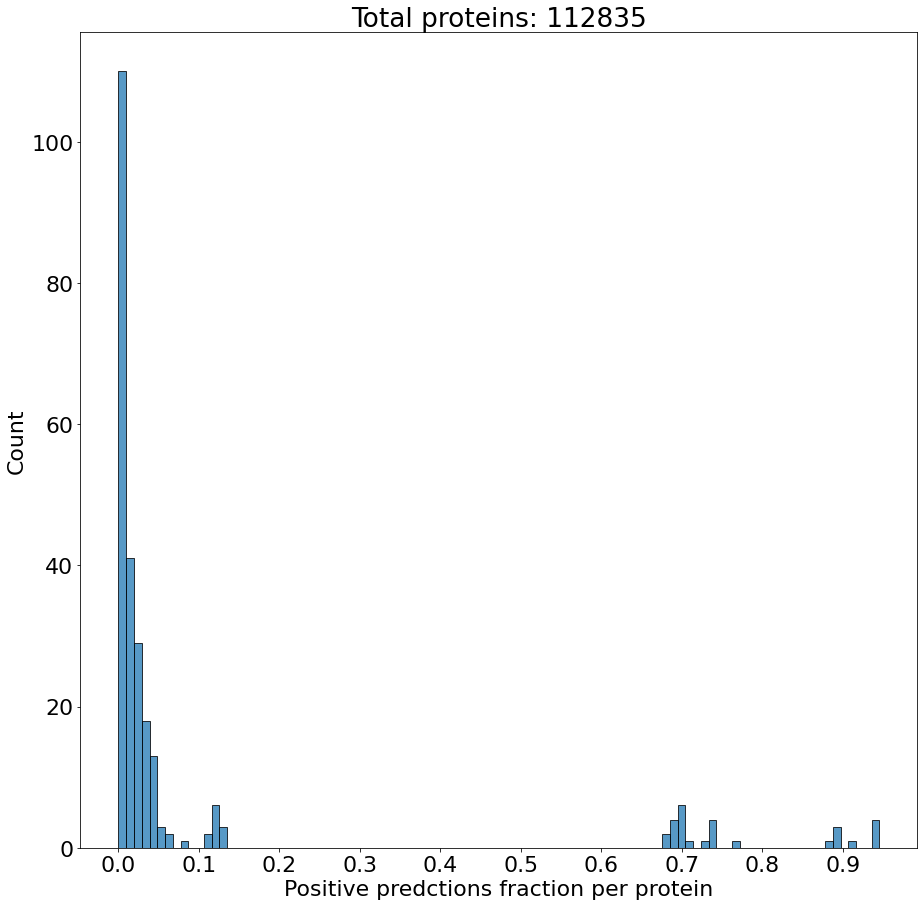

In [128]:
plt.rc("figure", figsize=(15, 15))
plt.rc("font", size=22)
sns.histplot(predicted_fractions)
plt.title(f"Total proteins: {n_proteins}")
_ = plt.xticks(np.arange(0, 1, 0.1))
plt.xlabel("Positive predctions fraction per protein")

### Calculate overall metrics

In [134]:
for species, pred_masks in predicted_masks.items():
    true_species_mask = []
    pred_species_mask = []
    for recid, mask in pred_masks.items():
        true_species_mask += true_masks[species][recid]
        pred_species_mask += predicted_masks[species][recid]
    print(f"Overall metrics for {species}: ", end="")
    print(f"precision={precision_score(true_species_mask, pred_species_mask):.2f}, ", end="")
    print(f"recall={recall_score(true_species_mask, pred_species_mask):.2f}, ", end="")
    print(f"f1={f1_score(true_species_mask, pred_species_mask):.2f}, ", end="")
    print(f"accuracy={accuracy_score(true_species_mask, pred_species_mask):.2f}")

Overall metrics for Vespa_mandarinia: precision=0.84, recall=1.00, f1=0.91, accuracy=1.00
Overall metrics for Bombus_pyrosoma: precision=0.16, recall=0.92, f1=0.28, accuracy=1.00
Overall metrics for Megalopta_genalis: precision=0.19, recall=1.00, f1=0.32, accuracy=1.00
Overall metrics for Leptopilina_heterotoma: precision=0.70, recall=0.98, f1=0.82, accuracy=1.00
Overall metrics for Apis_mellifera_caucasica: precision=0.40, recall=1.00, f1=0.58, accuracy=1.00


### Calculate metrics on filtered predictions

In [147]:
for species, pred_masks in predicted_masks.items():
    true_species_mask = []
    pred_species_mask = []
    for recid, mask in pred_masks.items():
        if sum(mask) / len(mask) > 0.5:
            true_species_mask += true_masks_unfiltered[species][recid]
            pred_species_mask += predicted_masks[species][recid]
    print(f"Metrics after filtering for {species}: ", end="")
    print(f"precision={precision_score(true_species_mask, pred_species_mask):.2f}, ", end="")
    print(f"recall={recall_score(true_species_mask, pred_species_mask):.2f}, ", end="")
    print(f"f1={f1_score(true_species_mask, pred_species_mask):.2f}, ", end="")
    print(f"accuracy={accuracy_score(true_species_mask, pred_species_mask):.2f}")

Metrics after filtering for Vespa_mandarinia: precision=1.00, recall=0.71, f1=0.83, accuracy=0.71
Metrics after filtering for Bombus_pyrosoma: precision=1.00, recall=0.71, f1=0.83, accuracy=0.71
Metrics after filtering for Megalopta_genalis: precision=1.00, recall=0.94, f1=0.97, accuracy=0.94
Metrics after filtering for Leptopilina_heterotoma: precision=1.00, recall=0.90, f1=0.95, accuracy=0.90
Metrics after filtering for Apis_mellifera_caucasica: precision=1.00, recall=0.89, f1=0.94, accuracy=0.89


Note that **recall** metric may be inacurate, because true labels are assigned to whole protein (including signal peptides, which are nnot participating in training)

In [75]:
os.path.split("config")

('', 'config')